**Ahmet Utku ELİK - Image Super Resolution - CNN**


In [ ]:
import numpy as np
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.image import ssim_multiscale
from tensorflow.nn import relu,depth_to_space
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Conv2D, Input, Add, Lambda,UpSampling2D, Dense, GlobalAveragePooling2D

In [ ]:
lr_dir = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/lowres"
hr_dir = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/highres"

lr_datagen = tf.keras.preprocessing.image.ImageDataGenerator()

hr_datagen = tf.keras.preprocessing.image.ImageDataGenerator()

batch_size = 32
target_size = (510, 510)

lr_iterator = lr_datagen.flow_from_directory(
    directory=lr_dir,
    target_size=(170,170),
    batch_size=1,
    class_mode=None,
    shuffle=False
)

hr_iterator = hr_datagen.flow_from_directory(
    directory=hr_dir,
    target_size=(510,510),
    batch_size=1,
    class_mode=None,
    shuffle=False
)
iterator = zip(lr_iterator, hr_iterator)

Found 3500 images belonging to 1 classes.
Found 3500 images belonging to 1 classes.


In [ ]:
lrv_dir = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/lowresvalid"
hrv_dir = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/highresvalid"

lrv_datagen = tf.keras.preprocessing.image.ImageDataGenerator()

hrv_datagen = tf.keras.preprocessing.image.ImageDataGenerator()

batch_size = 32
target_size = (510, 510)

lrv_iterator = lrv_datagen.flow_from_directory(
    directory=lrv_dir,
    target_size=(170,170),
    batch_size=1,
    class_mode=None,
    shuffle=False
)

hrv_iterator = hrv_datagen.flow_from_directory(
    directory=hrv_dir,
    target_size=(510,510),
    batch_size=1,
    class_mode=None,
    shuffle=False
)
iteratorv = zip(lrv_iterator, hrv_iterator)

Found 1000 images belonging to 1 classes.
Found 1000 images belonging to 1 classes.


In [ ]:
def ms_ssim(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32) / 255.0
    y_pred = tf.cast(y_pred, tf.float32) / 255.0
    ms_ssim = tf.reduce_mean(ssim_multiscale(y_true, y_pred, max_val=1.0))
    loss = 1 - ms_ssim
    return loss

In [ ]:
def ResBlock(input_layer, filters):
    x = Conv2D(filters=filters, kernel_size=3, padding='same', activation='relu')(input_layer)
    x = Conv2D(filters=filters, kernel_size=3, padding='same')(x)
    x = Add()([input_layer, x])
    return x
def InterConnected(input_shape):
    input_tensor = Input(shape=input_shape)
    x = Conv2D(filters=32, kernel_size=3, padding='same', activation='relu')(input_tensor)
    for i in range(2):
        x = ResBlock(x, 32)
    x = Conv2D(filters=32*9, kernel_size=3, padding='same')(x)
    x = Lambda(lambda x: tf.nn.depth_to_space(x, block_size=3))(x)
    output_tensor = Conv2D(filters=3, kernel_size=1)(x)
    model = Model(inputs=input_tensor, outputs=output_tensor)
    print(model.summary())
    return model
model=InterConnected((170,170,3))

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 170, 170, 3)]        0         []                            
                                                                                                  
 conv2d_7 (Conv2D)           (None, 170, 170, 32)         896       ['input_2[0][0]']             
                                                                                                  
 conv2d_8 (Conv2D)           (None, 170, 170, 32)         9248      ['conv2d_7[0][0]']            
                                                                                                  
 conv2d_9 (Conv2D)           (None, 170, 170, 32)         9248      ['conv2d_8[0][0]']            
                                                                                            

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.001), loss='mse', metrics=[ms_ssim,'mse'])

**Training Time: 5 dk/epoch**

In [ ]:
model.fit(iterator,validation_data=iteratorv,epochs=20,steps_per_epoch=3500,verbose=1,validation_steps=750)

In [ ]:
model.save_weights("resblock1_2_32_20.h5")

In [ ]:
model.load_weights("/content/drive/MyDrive/Image Super Resolution/ISR-1/model/resblock1_2_32_20.h5")

1/1 [==============================] - 2s 2s/step


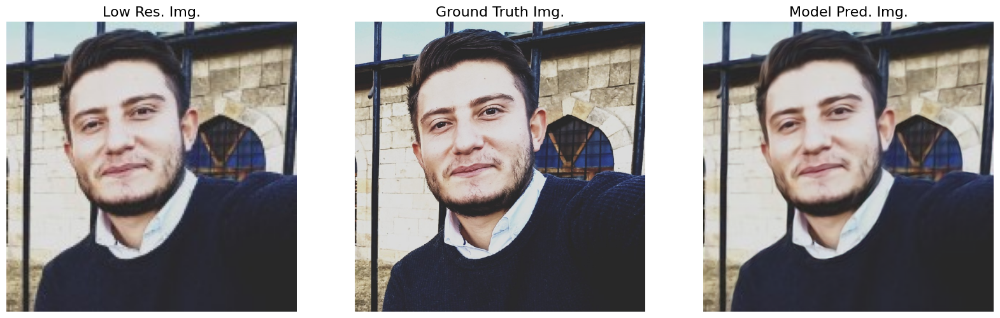

In [ ]:
from matplotlib import image as mpimg

LR_UTKU = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/LR_UTKU.jpg"
HR_UTKU = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/HR_UTKU.jpeg"

LR_UTKU_IMAGE = mpimg.imread(LR_UTKU)
HR_UTKU_IMAGE = mpimg.imread(HR_UTKU)

fig = plt.figure(figsize=(20, 20))
ax1 = fig.add_subplot(1, 3, 1)
plt.title('Low Res. Img.', fontsize=16)
ax1.axis('off')

ax2 = fig.add_subplot(1, 3, 2)
plt.title('Ground Truth Img.', fontsize=16)
ax2.axis('off')

ax3 = fig.add_subplot(1, 3, 3)
plt.title('Model Pred. Img.', fontsize=16)
ax3.axis('off')

ax1.imshow(LR_UTKU_IMAGE)
ax2.imshow(HR_UTKU_IMAGE)

img=Image.open(LR_UTKU)
arr=np.array(img)
pred=model.predict(arr.reshape(1,170,170,3))
pred=pred.astype(np.uint8)
ax3.imshow(pred[0])

1/1 [==============================] - 0s 160ms/step


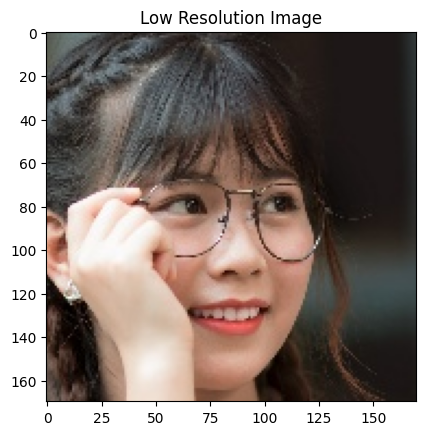

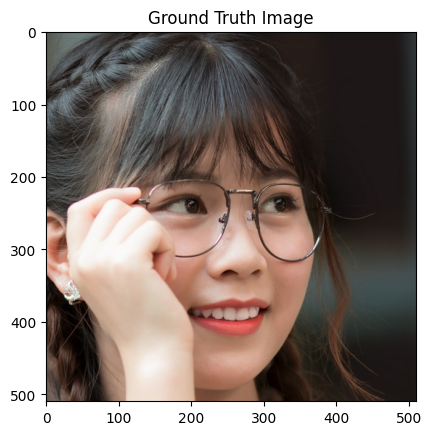

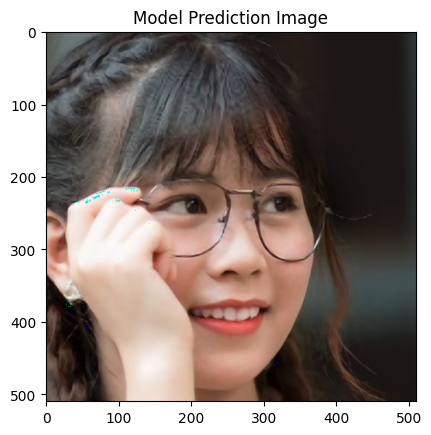

In [ ]:
from matplotlib import image as mpimg

test_lrv_img_path = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/lowresvalid/LowResolution_3x_Valid/Img_down3503.jpg"
test_hrv_img_path = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/highresvalid/HighResolution_Valid/Img3503.jpg"

LRV_IMAGE = mpimg.imread(test_lrv_img_path)
HRV_IMAGE = mpimg.imread(test_hrv_img_path)

plt.title("Low Resolution Image")
plt.imshow(LRV_IMAGE)
plt.figure()

plt.title("Ground Truth Image")
plt.imshow(HRV_IMAGE)
plt.figure()

plt.title("Model Prediction Image")
img=Image.open(test_lrv_img_path)
arr=np.array(img)
pred=model.predict(arr.reshape(1,170,170,3))
pred=pred.astype(np.uint8)
plt.imshow(pred[0])



1/1 [==============================] - 0s 156ms/step


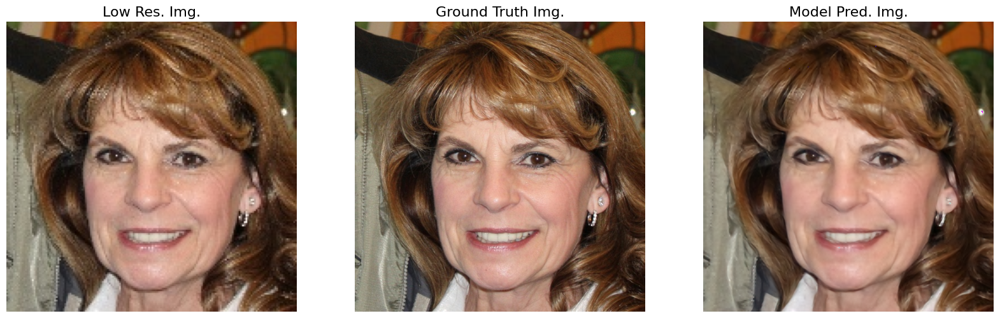

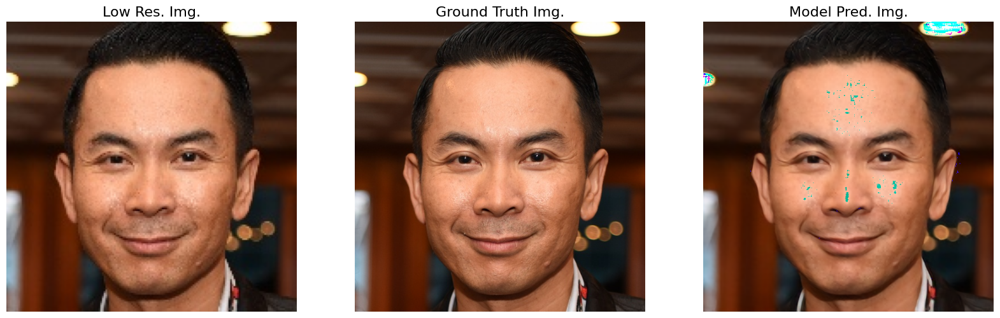

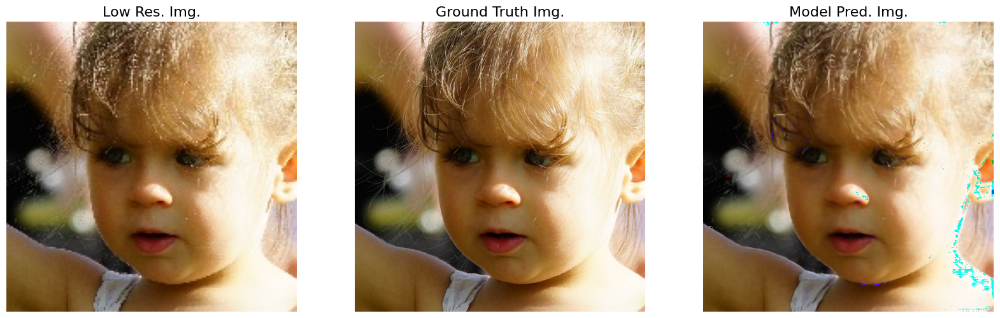

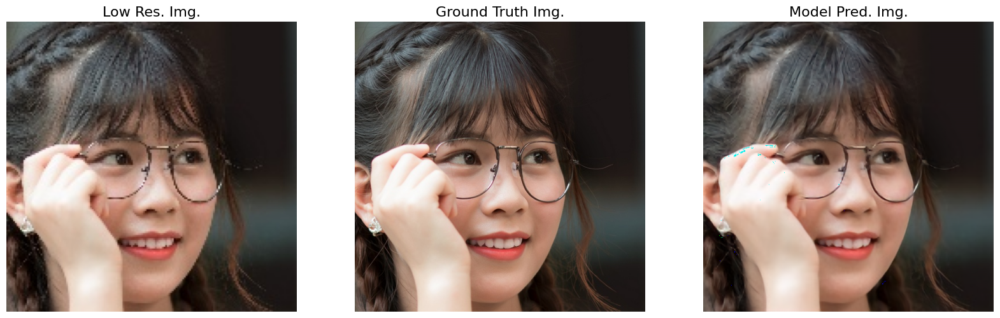

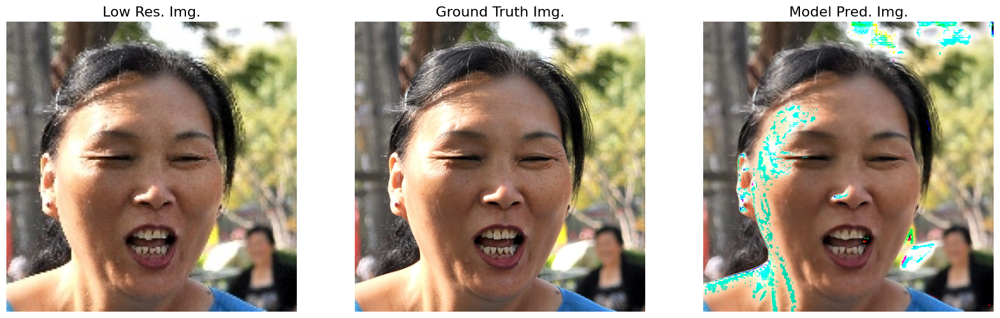

...

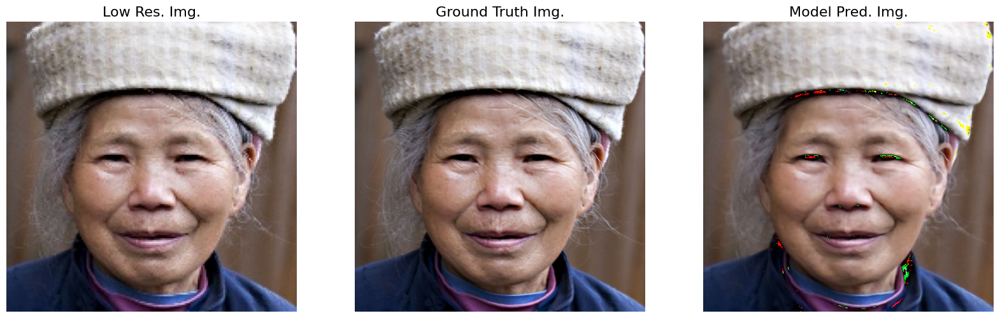

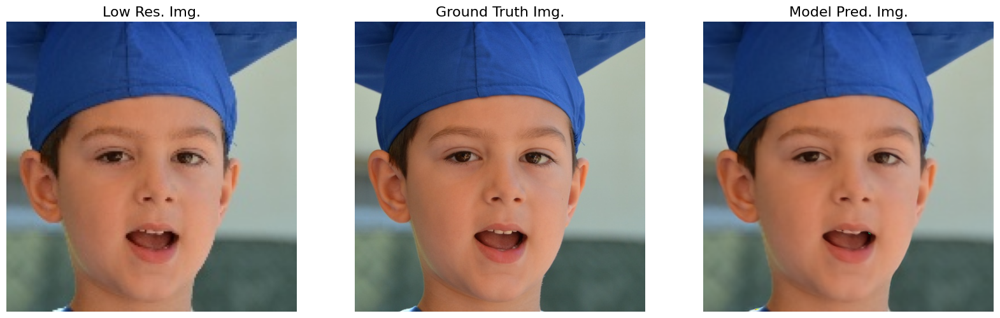

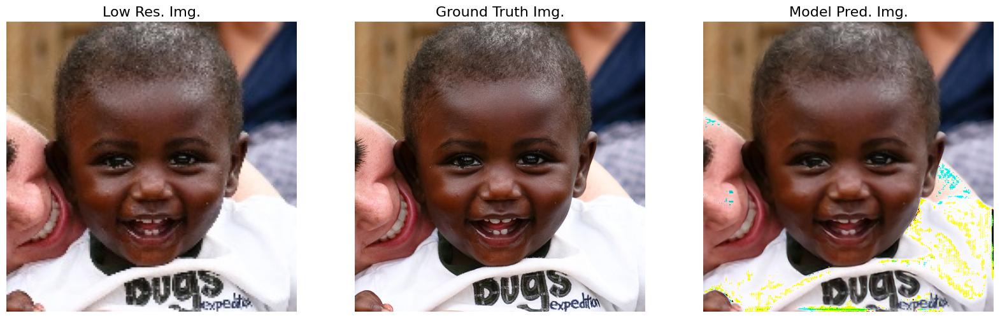

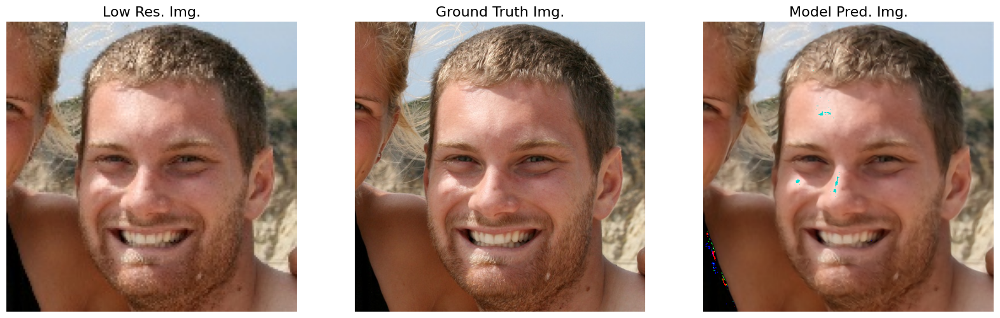

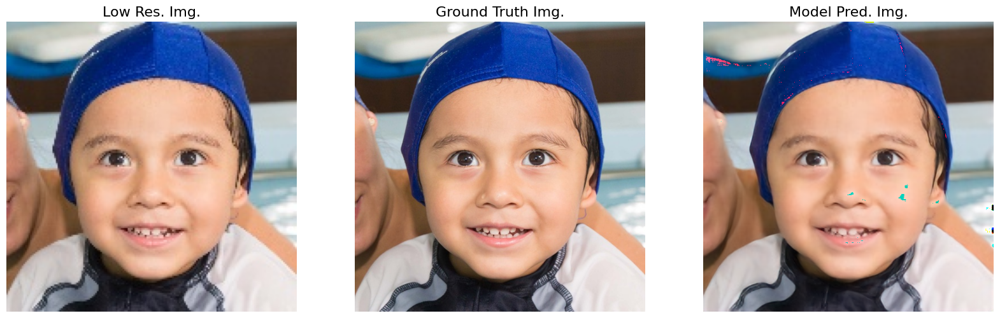

In [ ]:
for i in range(20):
  dizin1 = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/lowresvalid/LowResolution_3x_Valid/Img_down" + str(i+3500) + ".jpg"
  dizin2 = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/highresvalid/HighResolution_Valid/Img" + str(i+3500) + ".jpg"

  LRV_IMAGE = mpimg.imread(dizin1)
  HRV_IMAGE = mpimg.imread(dizin2)

  fig = plt.figure(figsize=(20, 20))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title('Low Res. Img.', fontsize=16)
  ax1.axis('off')

  ax2 = fig.add_subplot(1, 3, 2)
  plt.title('Ground Truth Img.', fontsize=16)
  ax2.axis('off')

  ax3 = fig.add_subplot(1, 3, 3)
  plt.title('Model Pred. Img.', fontsize=16)
  ax3.axis('off')

  img=Image.open(dizin1)
  arr=np.array(img)
  pred=model.predict(arr.reshape(1,170,170,3))
  pred=pred.astype(np.uint8)

  ax1.imshow(LRV_IMAGE)
  ax2.imshow(HRV_IMAGE)
  ax3.imshow(pred[0])

In [ ]:
test_lr_img_path = "/content/drive/MyDrive/Image Super Resolution/ISR-1/dataset/lowresvalid/LowResolution_3x_Valid/Img_down3503.jpg"

img=Image.open(test_lr_img_path)
arr=np.array(img)
pred=model.predict(arr.reshape(1,170,170,3))
pred=pred.astype(np.uint8)
plt.imshow(pred[0])